In [1]:
!pip install open3d


[notice] A new release of pip is available: 23.2.1 -> 23.3
[notice] To update, run: pip install --upgrade pip


In [1]:
import argparse
import configparser
import os
import sys
import json 
from pathlib import Path

import numpy as np
import matplotlib.pyplot as plt
import cv2
import open3d as o3d

import ipywidgets as widgets
from ipywidgets import interact, interact_manual, interactive
from IPython.display import display

from matplotlib import pyplot as plt

from glob import glob
from PIL import Image

import spatialmath as sm

from tqdm import tqdm

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


### Data


In [2]:
# load images

# find the path to the json files for the two trajectories
basepath = Path().absolute() # Get this notebooks path
trajectory_1_path = (basepath / "trajectory_1")
trajectory_2_path = (basepath / "trajectory_2")

# load the json file for trajectory 1
with open(trajectory_1_path / "trajectory_1.json") as f:
    traj1 = json.load(f)
    
# load the json file for trajectory 2
with open(trajectory_2_path / "trajectory_2.json") as f:
    traj2 = json.load(f)

traj1_img_fn = [(trajectory_1_path / frame['file_path']) for frame in traj1["frames"]]
imgs_db = [np.array(Image.open(fn)) for fn in traj1_img_fn]
depth_db = [np.array(Image.open((trajectory_1_path / frame['depth_path']))) for frame in traj1['frames']]

traj2_img_fn = [(trajectory_2_path / frame['file_path']) for frame in traj2["frames"]]
imgs_q = [np.array(Image.open(fn)) for fn in traj2_img_fn]
depth_q = [np.array(Image.open((trajectory_2_path / frame['depth_path']))) for frame in traj2['frames']]

# rgbd_db = []
# for frame in traj1['frames']:
#     img_path = (trajectory_1_path / frame['file_path'])
#     depth_path = (trajectory_1_path / frame['depth_path'])
#     color_raw = o3d.io.read_image(str(img_path))
#     depth_raw = o3d.io.read_image(str(depth_path))
#     rgbd_image = o3d.geometry.RGBDImage.create_from_color_and_depth(
#         color_raw, depth_raw)
#     rgbd_image.depth = depth_raw
#     rgbd_db.append(rgbd_image)

# rgbd_q = []
# for frame in traj1['frames']:
#     img_path = (trajectory_2_path / frame['file_path'])
#     depth_path = (trajectory_2_path / frame['depth_path'])
#     color_raw = o3d.io.read_image(str(img_path))
#     depth_raw = o3d.io.read_image(str(depth_path))
#     rgbd_image = o3d.geometry.RGBDImage.create_from_color_and_depth(
#         color_raw, depth_raw)
#     rgbd_image.depth = depth_raw
#     rgbd_q.append(rgbd_image)


In [3]:
# Initialize camera parameters
fx1 = traj1['fl_x'] # Focal length in pixels
fy1 = traj1['fl_y']
cx1 = traj1['cx']  # Principal point in pixels
cy1 = traj1['cy']
K1 = np.array([[fx1, 0, cx1], [0, fy1, cy1], [0, 0, 1]])

fx2 = traj1['fl_x'] # Focal length in pixels
fy2 = traj1['fl_y']
cx2 = traj1['cx']  # Principal point in pixels
cy2 = traj1['cy']
K2 = np.array([[fx2, 0, cx2], [0, fy2, cy2], [0, 0, 1]])


wTc_1 = sm.SE3(traj1['frames'][0]['transform_matrix'])

### COLMAP pcl generation

In [ ]:
# apparently sudo isn't a command


In [ ]:
from getpass import getpass
!echo {getpass()} | su -
!apt-get install sudo -y
!usermod -aG sudo ${USER}
!sudo apt-get install \
    git \
    cmake \
    ninja-build \
    build-essential \
    libboost-program-options-dev \
    libboost-filesystem-dev \
    libboost-graph-dev \
    libboost-system-dev \
    libeigen3-dev \
    libflann-dev \
    libfreeimage-dev \
    libmetis-dev \
    libgoogle-glog-dev \
    libgtest-dev \
    libsqlite3-dev \apt install \
    libglew-dev \
    qtbase5-dev \
    libqt5opengl5-dev \
    libcgal-dev \
    libceres-dev

!sudo apt-get install -y \
    nvidia-cuda-toolkit \
    nvidia-cuda-toolkit-gcc

In [ ]:
# colmap
!git clone --recursive https://github.com/colmap/colmap
!cd colmap
!git checkout dev
!mkdir build
!cd build
!cmake .. -GNinja
!ninja
!sudo ninja install
!cd ../..

!sudo apt-get install -y \
    nvidia-cuda-toolkit \
    nvidia-cuda-toolkit-gcc

In [ ]:
# pycolmap
!git clone -b v0.4.0 --recursive git@github.com:colmap/pycolmap.git
!cd pycolmap
!pip install .
!cd ..

In [ ]:
output_path: pathlib.Path
image_dir: pathlib.Path

image_dir = (trajectory_1_path / "images")
output_path = (basepath / "colmap")

mvs_path = output_path / "mvs"
database_path = output_path / "database.db"

In [ ]:
# # Generate point cloud map
# pycolmap.extract_f>

In [7]:
# # dense reconstruction
# pycolmap.undistort_images(mvs_path, output_path, image_dir)
# pycolmap.patch_match_stereo(mvs_path)  # requires compilation with CUDA
# pycolmap.stereo_fusion(mvs_path / "dense.ply", mvs_path)

### Open3D PCL Gen

In [4]:
rgbd_db = []
for frame in traj1['frames']:
    img_path = str((trajectory_1_path / frame['file_path']))
    depth_path = str((trajectory_1_path / frame['depth_path']))
    color_raw = o3d.io.read_image(img_path)
    depth_raw = o3d.io.read_image(depth_path)
    rgbd_image = o3d.geometry.RGBDImage.create_from_color_and_depth(
    color_raw, depth_raw, depth_scale=1/traj1['integer_depth_scale'], depth_trunc=8)
    rgbd_db.append(rgbd_image)


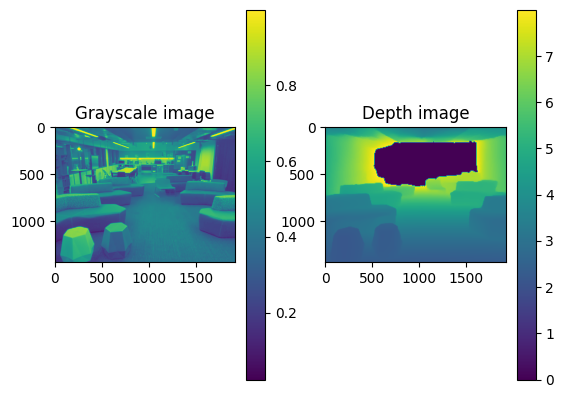

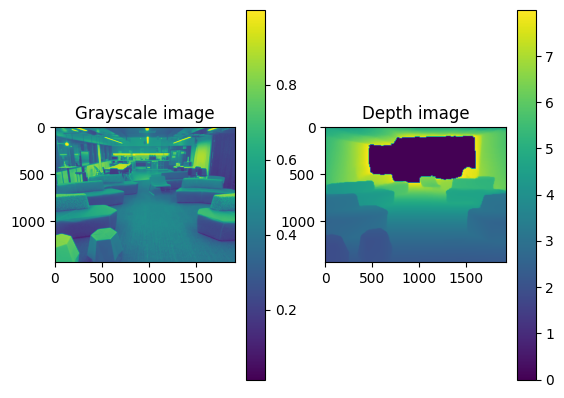

In [5]:
# Plot the images
plt.subplot(1, 2, 1)
plt.title('Grayscale image')
plt.imshow(rgbd_db[0].color)
plt.colorbar()
plt.subplot(1, 2, 2)
plt.title('Depth image')
plt.imshow(rgbd_db[0].depth)
plt.colorbar()
plt.show()

plt.subplot(1, 2, 1)
plt.title('Grayscale image')
plt.imshow(rgbd_db[1].color)
plt.colorbar()
plt.subplot(1, 2, 2)
plt.title('Depth image')
plt.imshow(rgbd_db[1].depth)
plt.colorbar()
plt.show()

In [6]:
camera_intrinsic = o3d.camera.PinholeCameraIntrinsic(1920, 1440, K1)
pcd = o3d.geometry.PointCloud.create_from_rgbd_image(rgbd_db[0], camera_intrinsic)
for i in tqdm(range(1, len(rgbd_db), 1)):
    pcd += o3d.geometry.PointCloud.create_from_rgbd_image(rgbd_db[i], camera_intrinsic)

 94%|█████████▍| 47/50 [00:08<00:00,  6.40it/s]

: 

In [85]:
option = o3d.pipelines.odometry.OdometryOption(depth_diff_max=1, depth_min=0, depth_max=10)
odo_init = np.identity(4)

rel_traj = []
for i in tqdm(range(1, len(rgbd_db), 3)):
    prev_rgbd = rgbd_db[i-1]
    curr_rgbd = rgbd_db[i]
    [success_hybrid_term, trans_hybrid_term, info] = o3d.pipelines.odometry.compute_rgbd_odometry(
     prev_rgbd, curr_rgbd, camera_intrinsic, odo_init,
     o3d.pipelines.odometry.RGBDOdometryJacobianFromHybridTerm(), option)
    rel_traj.append(sm.SE3(trans_hybrid_term))

100%|██████████| 17/17 [00:58<00:00,  3.46s/it]


In [86]:
for i, rel in enumerate(rel_traj):
    rel_traj[i] = rel.inv()

In [87]:
abs_traj = []
abs_traj.append(wTc_1)
for c1Tc2 in rel_traj:
    # this is the pose of the current camera in the world frame
    abs_traj.append(abs_traj[-1] * sm.SE3(c1Tc2))
    

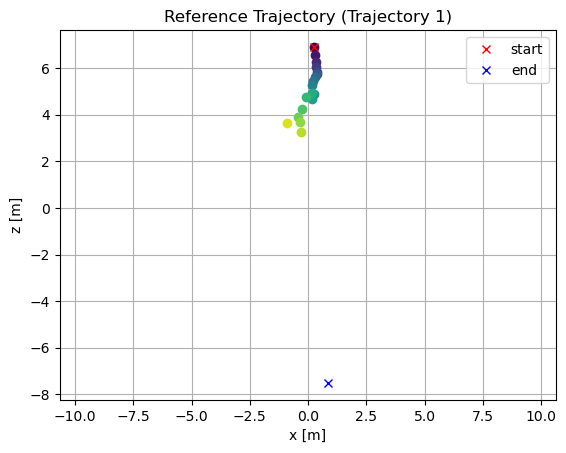

In [88]:
cm = plt.colormaps['viridis']

for i, xfm in enumerate(abs_traj):
    # plot the points and use a color ramp to indicate time
    
    color = cm( i / len(abs_traj))
    plt.plot(xfm.t[0], xfm.t[2], "o", color=color)

# indicate start and end of the trajectory with a special marker
xfm = np.array(traj1["frames"][0]["transform_matrix"])
plt.plot(xfm[0, 3], xfm[2, 3], "x", color="red", label="start")
xfm = np.array(traj1["frames"][-1]["transform_matrix"])
plt.plot(xfm[0, 3], xfm[2, 3], "x", color="blue", label="end")


plt.axis('equal'); plt.grid('on'); plt.legend()
plt.xlabel('x [m]'); plt.ylabel('z [m]')
plt.title('Reference Trajectory (Trajectory 1)')
plt.show()

In [ ]:
# Flip it, otherwise the pointcloud will be upside down
# pcd.transform([[1, 0, 0, 0], [0, -1, 0, 0], [0, 0, -1, 0], [0, 0, 0, 1]])
# o3d.visualization.draw_geometries([pcd])

### Visual Odometry/SLAM
get trajectories and resulting pose graph  

https://www.researchgate.net/publication/313660691_An_evaluation_of_real-time_RGB-D_visual_odometry_algorithms_on_mobile_devices


In [151]:
# Initialize detector
orb = cv2.ORB_create()
# sift = cv2.SIFT_create()
detect_features = orb.detectAndCompute

# Create a brute-force matcher for feature matching
bf = cv2.BFMatcher()#(cv2.NORM_HAMMING, crossCheck=True)
match_features = bf.knnMatch

# Initialize transformation matrix
T = np.identity(4)

# Initialize an empty list to store transformation matrices
trajectory = []

# Initialize the first frame
prev_frame = None

In [166]:
def est_motion(img1, img2, depth1, depth2, K, depth_factor):
    # extract features
    kp1, des1 = detect_features(img1, None)
    kp2, des2 = detect_features(img2, None)

    # match features
    matches = match_features(des2, des1, k=2)

    # Apply ratio test
    good_matches = []
    for m,n in matches:
         if m.distance < 0.75*n.distance:
            good_matches.append([m])
    
    # Only considering keypoints that are matched for two sequential frames
    image1_points = np.float32(
        [kp1[m[0].trainIdx].pt for m in good_matches])
    image2_points = np.float32(
        [kp2[m[0].queryIdx].pt for m in good_matches])         

    # 3D calc current
    pts_3d_2, outliers = calc_3d(image2_points, depth2, K, depth_factor=depth_factor, max_depth=100)
    # Deleting the false depth points
    image1_points = np.delete(image1_points, outliers, 0)
    image2_points = np.delete(image2_points, outliers, 0)

    # # Apply Ransac Algorithm to remove outliers
    _, rvec, t, _ = cv2.solvePnPRansac(
        pts_3d_2, image1_points, K, None)

    R = cv2.Rodrigues(rvec)[0]

    return (sm.SE3(t) * sm.SE3(sm.SO3(R)), pts_3d_2)  
    
def calc_3d(img_points, depth, camera_mat, depth_factor=1, max_depth=100):
    points_3D = np.zeros((0, 3))
    outliers = []

    # Extract depth information to build 3D positions
    for indices, (u, v) in enumerate(img_points):
        z = depth[int(v), int(u)] * depth_factor
        # We will not consider depth greater than max_depth
        if z > max_depth or z <= 0:
            outliers.append(indices)
            continue

        # Using z we can find the x,y points in 3D coordinate using the formula
        fx = camera_mat[0,0]
        fy = camera_mat[1,1]
        x = z*(u-cx)/fx
        y = z*(v-cy)/fy

        # Stacking all the 3D (x,y,z) points
        points_3D = np.vstack([points_3D, np.array([x, y, z])])
    return points_3D, outliers


In [164]:
# # # From Nielson VO
# def track_keypoints(img1, img2, kp1, k_params, max_error=4):
#         """
#         Tracks the keypoints between frames

#         Parameters
#         ----------
#         img1 (ndarray): i-1'th image. Shape (height, width)
#         img2 (ndarray): i'th image. Shape (height, width)
#         kp1 (ndarray): Keypoints in the i-1'th image. Shape (n_keypoints)
#         max_error (float): The maximum acceptable error

#         Returns
#         -------
#         trackpoints1 (ndarray): The tracked keypoints for the i-1'th image. Shape (n_keypoints_match, 2)
#         trackpoints2 (ndarray): The tracked keypoints for the i'th image. Shape (n_keypoints_match, 2)
#         """
#         # Convert the keypoints into a vector of points and expand the dims so we can select the good ones
#         trackpoints1 = np.expand_dims(cv2.KeyPoint_convert(kp1), axis=1)

#         # Use optical flow to find tracked counterparts
#         trackpoints2, st, err = cv2.calcOpticalFlowPyrLK(img1, img2, trackpoints1, None, k_params)

#         # Convert the status vector to boolean so we can use it as a mask
#         trackable = st.astype(bool)

#         # Create a maks there selects the keypoints there was trackable and under the max error
#         under_thresh = np.where(err[trackable] < max_error, True, False)

#         # Use the mask to select the keypoints
#         trackpoints1 = trackpoints1[trackable][under_thresh]
#         trackpoints2 = np.around(trackpoints2[trackable][under_thresh])

#         # Remove the keypoints there is outside the image
#         h, w, _ = img1.shape
#         in_bounds = np.where(np.logical_and(trackpoints2[:, 1] < h, trackpoints2[:, 0] < w), True, False)
#         trackpoints1 = trackpoints1[in_bounds]
#         trackpoints2 = trackpoints2[in_bounds]
    
#         return trackpoints1, trackpoints2

# def calc_3d(img_points, depth, depth_factor, max_depth=100000):
#     points_3D = np.zeros((0, 3))
#     outliers = []

#     # Extract depth information to build 3D positions
#     for indices, (u, v) in enumerate(img_points):
#         z = depth[int(v), int(u)] * depth_factor
#         # We will not consider depth greater than max_depth
#         if z > max_depth:
#             outliers.append(indices)
#             continue

#         # Using z we can find the x,y points in 3D coordinate using the formula
#         x = z*(u-cx)/fx
#         y = z*(v-cy)/fy

#         # Stacking all the 3D (x,y,z) points
#         points_3D = np.vstack([points_3D, np.array([x, y, z])])
#     return points_3D, outliers

# def est_motion(img1, img2, depth1, depth2, K, depth_factor):
    
#     # extract features
#     kp1, des1 = detect_features(img1, None)
#     kp2, des2 = detect_features(img2, None)

#     # match features
#     image1_points, image2_points = track_keypoints(img1, img2, kp1, K)

#     # Calculate the 3D points
#     # pts_3d_1 = calc_3d(image1_points, depth1)
#     pts_3d_2, outliers = calc_3d(image2_points, depth2, depth_factor, max_depth=8)
    
#     # Deleting the false depth points
#     image1_points = np.delete(image1_points, outliers, 0)
#     image2_points = np.delete(image2_points, outliers, 0)
    
#     # # Apply Ransac Algorithm to remove outliers
#     _, rvec, t, _ = cv2.solvePnPRansac(
#         pts_3d_2, image1_points, K, None)

#     R = cv2.Rodrigues(rvec)[0]

#     return (sm.SE3(t) * sm.SE3(sm.SO3(R)), pts_3d_2)  

In [165]:
# Test against Trajectory 1 (compare w/ gt)
relative_poses = []

for i in range(1, len(imgs_db)):
    T, pts_3d = est_motion(imgs_db[i-1], imgs_db[i], depth_db[i-1], depth_db[i], K, traj1['integer_depth_scale'])
    
    relative_poses.append(T)


(1440, 1920, 3)
(1440, 1920, 3)
(1440, 1920, 3)


error: OpenCV(4.7.0) /home/conda/feedstock_root/build_artifacts/libopencv_1675729947212/work/modules/calib3d/src/solvepnp.cpp:242: error: (-215:Assertion failed) npoints >= 4 && npoints == std::max(ipoints.checkVector(2, CV_32F), ipoints.checkVector(2, CV_64F)) in function 'solvePnPRansac'


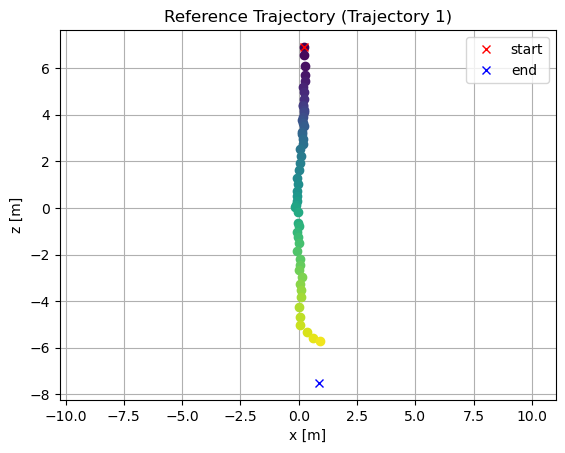

In [133]:
abs_traj = []
abs_traj.append(wTc_1)
for c1Tc2 in relative_poses:
    # this is the pose of the current camera in the world frame
    abs_traj.append(abs_traj[-1] * sm.SE3(c1Tc2))

cm = plt.colormaps['viridis']

for i, xfm in enumerate(abs_traj):
    # plot the points and use a color ramp to indicate time
    
    color = cm( i / len(abs_traj))
    plt.plot(xfm.t[0], xfm.t[2], "o", color=color)

# indicate start and end of the trajectory with a special marker
xfm = np.array(traj1["frames"][0]["transform_matrix"])
plt.plot(xfm[0, 3], xfm[2, 3], "x", color="red", label="start")
xfm = np.array(traj1["frames"][-1]["transform_matrix"])
plt.plot(xfm[0, 3], xfm[2, 3], "x", color="blue", label="end")


plt.axis('equal'); plt.grid('on'); plt.legend()
plt.xlabel('x [m]'); plt.ylabel('z [m]')
plt.title('Estimated Trajectory (Trajectory 1)')
plt.show()

In [155]:
if (imgs_q[0] != imgs_db[0]).all():
    imgs_q.insert(0, imgs_db[0])
    depth_q.insert(0, depth_db[0])

In [156]:
# Find traj 2
relative_poses = []

for i in range(1, len(imgs_q)):
    T, pts_3d = est_motion(imgs_q[i-1], imgs_q[i], depth_q[i-1], depth_q[i], K2, traj2['integer_depth_scale'])
    
    relative_poses.append(T)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


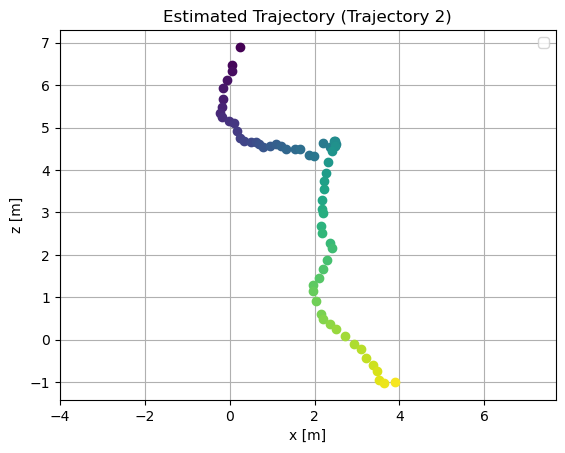

In [158]:
abs_traj = []
abs_traj.append(wTc_1)
for c1Tc2 in relative_poses:
    # this is the pose of the current camera in the world frame
    abs_traj.append(abs_traj[-1] * sm.SE3(c1Tc2))

cm = plt.colormaps['viridis']

for i, xfm in enumerate(abs_traj):
    # plot the points and use a color ramp to indicate time
    
    color = cm( i / len(abs_traj))
    plt.plot(xfm.t[0], xfm.t[2], "o", color=color)
    
plt.axis('equal'); plt.grid('on'); plt.legend()
plt.xlabel('x [m]'); plt.ylabel('z [m]')
plt.title('Estimated Trajectory (Trajectory 2)')
plt.show()

### Place Recognition
find the top matching places between query and database (traj2 and traj1 respectively)

In [6]:
!git clone https://github.com/stschubert/VPR_Tutorial.git
!git clone https://github.com/QVPR/Patch-NetVLAD.git PatchNetVLAD
!pip install faiss-gpu faiss-cpu


fatal: destination path 'VPR_Tutorial' already exists and is not an empty directory.
fatal: destination path 'PatchNetVLAD' already exists and is not an empty directory.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.5/85.5 MB 5.3 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.6/17.6 MB 7.4 MB/s eta 0:00:0000:0100:01m

[notice] A new release of pip is available: 23.2.1 -> 23.3
[notice] To update, run: pip install --upgrade pip
Obtaining file:///home/castrou/university/enn583/project2/PatchNetVLAD
  Preparing metadata (setup.py) ... done
  Running setup.py develop for patchnetvlad

[notice] A new release of pip is available: 23.2.1 -> 23.3
[notice] To update, run: pip install --upgrade pip
Traceback (most recent call last):
  File "/home/castrou/university/enn583/project2/./PatchNetVLAD/download_models.py", line 6, in <module>
    from patchnetvlad.tools import PATCHNETVLAD_ROOT_DIR
  File "/home/castrou/university/enn583/project2/PatchNetVLAD/patchnetvlad

In [9]:
!cd PatchNetVLAD; pip install --no-deps -e .
!python ./PatchNetVLAD/download_models.py


Obtaining file:///home/castrou/university/enn583/project2
ERROR: file:///home/castrou/university/enn583/project2 does not appear to be a Python project: neither 'setup.py' nor 'pyproject.toml' found.

[notice] A new release of pip is available: 23.2.1 -> 23.3
[notice] To update, run: pip install --upgrade pip
python: can't open file '/home/castrou/university/enn583/project2/./download_models.py': [Errno 2] No such file or directory


In [4]:
!pip install tensorflow
!pip install tensorflow_hub

  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/e2/7a/c7762c698fb1ac41a7e3afee51dc72aa3ec74ae8d2f57ce19a9cded3a4af/tensorflow-2.14.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
  Obtaining dependency information for absl-py>=1.0.0 from https://files.pythonhosted.org/packages/01/e4/dc0a1dcc4e74e08d7abedab278c795eef54a224363bb18f5692f416d834f/absl_py-2.0.0-py3-none-any.whl.metadata
  Obtaining dependency information for flatbuffers>=23.5.26 from https://files.pythonhosted.org/packages/6f/12/d5c79ee252793ffe845d58a913197bfa02ae9a0b5c9bc3dc4b58d477b9e7/flatbuffers-23.5.26-py2.py3-none-any.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 7.1 MB/s eta 0:00:00
  Obtaining dependency information for h5py>=2.9.0 from https://files.pythonhosted.org/packages/3b/d3/ecb4b3d2ec2c84132987e5f12ab1408f455bec1d90cd5bc408ebf37800f5/h5py-3.10.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
 

In [8]:
from VPR_Tutorial.evaluation.metrics import createPR, recallAt100precision, recallAtK
from VPR_Tutorial.evaluation import show_correct_and_wrong_matches
from VPR_Tutorial.matching import matching
import PatchNetVLAD.patchnetvlad as patchnetvlad

ImportError: cannot import name 'tools' from partially initialized module 'PatchNetVLAD.patchnetvlad' (most likely due to a circular import) (/home/castrou/university/enn583/project2/PatchNetVLAD/patchnetvlad/__init__.py)

In [ ]:
# Widget for selecting a descriptor
def select_descriptor(Descriptor=['HDC-DELF', 'AlexNet-conv3', 'NetVLAD', 'PatchNetVLAD']):
    return Descriptor
w = interactive(select_descriptor)
display(w)

interactive(children=(Dropdown(description='Descriptor', options=('HDC-DELF', 'AlexNet-conv3', 'NetVLAD', 'Pat…

In [ ]:
descriptor = w.result

print(f'===== Compute {descriptor} descriptors')
feature_extractor = None
if descriptor == 'HDC-DELF':
    from VPR_Tutorial.feature_extraction.feature_extractor_holistic import HDCDELF
    feature_extractor = HDCDELF()
elif descriptor == 'AlexNet-conv3':
    from VPR_Tutorial.feature_extraction.feature_extractor_holistic import AlexNetConv3Extractor
    feature_extractor = AlexNetConv3Extractor()
elif descriptor == 'NetVLAD' or descriptor == 'PatchNetVLAD':
    from VPR_Tutorial.feature_extraction.feature_extractor_patchnetvlad import PatchNetVLADFeatureExtractor
    from patchnetvlad.tools import PATCHNETVLAD_ROOT_DIR
    if w.result == 'NetVLAD':
        configfile = os.path.join(PATCHNETVLAD_ROOT_DIR, 'configs/netvlad_extract.ini')
    else:
        configfile = os.path.join(PATCHNETVLAD_ROOT_DIR, 'configs/speed.ini')
    assert os.path.isfile(configfile)
    config = configparser.ConfigParser()
    config.read(configfile)
    feature_extractor = PatchNetVLADFeatureExtractor(config)

print('===== Compute reference set descriptors')
db_D_holistic = feature_extractor.compute_features(imgs_db)
print('===== Compute query set descriptors')
q_D_holistic = feature_extractor.compute_features(imgs_q)
print('===== Completed')

===== Compute NetVLAD descriptors
Using GPU


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /home/n11552123/enn583/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:09<00:00, 57.5MB/s] 


=> loading checkpoint '/home/n11552123/enn583/enn583/proj2/PatchNetVLAD/patchnetvlad/./pretrained_models/mapillary_WPCA512.pth.tar'
=> loaded checkpoint '/home/n11552123/enn583/enn583/proj2/PatchNetVLAD/patchnetvlad/./pretrained_models/mapillary_WPCA512.pth.tar'
===== Compute reference set descriptors


  0%|          | 0/11 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/torch/nn/modules/conv.py:459: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1682343995026/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


===== Compute query set descriptors


  0%|          | 0/13 [00:00<?, ?it/s]

===== Completed


===== Compute cosine similarities S


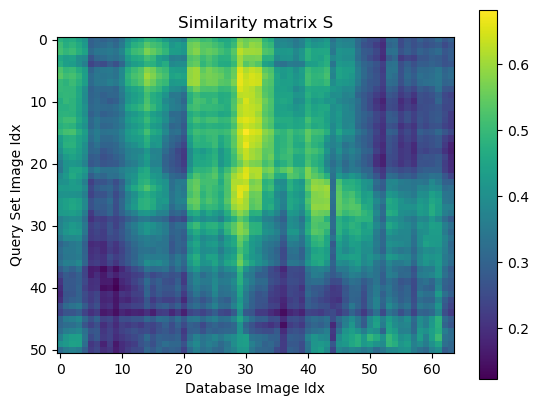

In [ ]:
# compare all descriptors and compute similarity matrix S
print('===== Compute cosine similarities S')

# normalize descriptors and compute S-matrix
db_D_holistic = db_D_holistic / np.linalg.norm(db_D_holistic , axis=1, keepdims=True)
q_D_holistic = q_D_holistic / np.linalg.norm(q_D_holistic , axis=1, keepdims=True)
S = np.matmul(db_D_holistic , q_D_holistic.transpose())

# show similarity matrix S
fig = plt.imshow(S)
fig.axes.set_xlabel('Database Image Idx')
fig.axes.set_ylabel('Query Set Image Idx')
fig.axes.set_title('Similarity matrix S')
plt.colorbar()
plt.show()

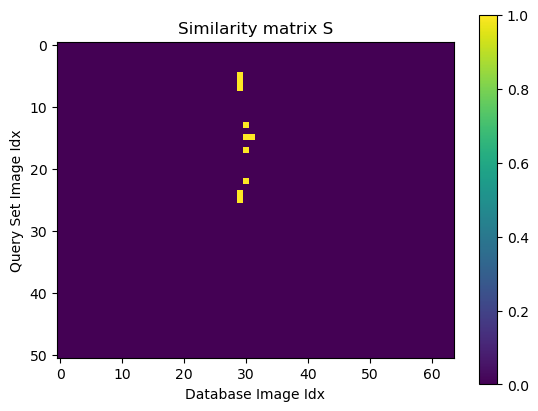

In [ ]:
S_strong = S > 0.65
fig = plt.imshow(S_strong)
fig.axes.set_xlabel('Database Image Idx')
fig.axes.set_ylabel('Query Set Image Idx')
fig.axes.set_title('Similarity matrix S')
plt.colorbar()
plt.show()

In [ ]:
good_matches = np.transpose(S_strong.nonzero())
print(good_matches)

[[ 5 29]
 [ 6 29]
 [ 7 29]
 [13 30]
 [15 30]
 [15 31]
 [17 30]
 [22 30]
 [24 29]
 [25 29]]


In [ ]:
# Compute pose transform between strong match frames


In [ ]:
# Pose Graph Optimisation
# close the loop by connecting pose_graph2 with pose_graph1 (ground truth) via VPR matches

### Object Detection
find the mugs within traj2


In [ ]:
from torchvision.io.image import read_image
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2, FasterRCNN_ResNet50_FPN_V2_Weights, fcos_resnet50_fpn, FCOS_ResNet50_FPN_Weights, retinanet_resnet50_fpn_v2, RetinaNet_ResNet50_FPN_V2_Weights
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image

import torch

from colormap import sample_colors

from matplotlib.lines import Line2D


In [ ]:
weights_frcnn = FasterRCNN_ResNet50_FPN_V2_Weights.COCO_V1
frcnn = fasterrcnn_resnet50_fpn_v2(weights=weights_frcnn, box_score_thresh=0.2)
frcnn.eval()

weights_fcos = FCOS_ResNet50_FPN_Weights.COCO_V1
fcos = fcos_resnet50_fpn(weights=weights_fcos, box_score_thresh=0.2)
fcos.eval()

FCOS(
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=1e-05)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=1e-05)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=1e-05)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=1e-05)
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(256, eps=1e

In [ ]:
models = {'F-RCNN': frcnn, 'FCOS': fcos}
weights = {'F-RCNN': weights_frcnn, 'FCOS': weights_fcos}

In [ ]:
coco_categories = weights_fcos.meta["categories"]
def draw_detections(img, prediction, detectorName='F-RCNN', thresh = 0):

    mask = prediction['scores'] >= thresh
    prediction['boxes'] = prediction['boxes'][mask]
    prediction['labels'] = prediction['labels'][mask]
    prediction['scores'] = prediction['scores'][mask]

    
    #extract the labels and scores -- combine these into text that can be printed on the image
    labels = [coco_categories[i] for i in prediction["labels"]]
    scores = [f'{int(100.*torch.round(s, decimals=2))}%' for s in prediction['scores']]
    print_txt = [f'{labels[i]}: {scores[i]}' for i in range(len(prediction['scores']))]
    
    color_list_int = []
    if len(scores) > 0:
        # picks colors that are visually distinct to draw on the image
        color_list = sample_colors(len(scores), rgb = True)
        color_list_int = [(int(c[0]), int(c[1]), int(c[2])) for c in color_list]

    #creates a tensor image with the bboxes drawn on the image
    box = draw_bounding_boxes(img, boxes=prediction["boxes"],
                              labels=print_txt,
                              colors=color_list_int,
                              width=6, font_size=50)

    #put the image in format compatible with matplotlib
    box = box.numpy()
    box = np.swapaxes(box, 0, 1)
    box = np.swapaxes(box, 1, 2)
    
    npimg = img.numpy()
    npimg = np.swapaxes(npimg, 0, 1)
    npimg = np.swapaxes(npimg, 1, 2)
    
    #draw with matplotlib
    fig, ax = plt.subplots(1, 2, figsize=(12,8))
    # ax.set_title(f'{detectorName}')
    ax[1].imshow(box)
    ax[0].imshow(npimg)
    ax[0].set_ylabel(f'{detectorName}', rotation = 0, labelpad = 50, fontsize = 15)

    
    #text is hard to read -- create a custom legend
    custom_lines = []
    for c in color_list_int:
        c_plt = (c[0]/255, c[1]/255, c[2]/255)
        custom_lines += [Line2D([0], [0], color = c_plt, lw = 4)]
    fig.legend(custom_lines, print_txt, loc = 'outside right center')
                            
    plt.show()

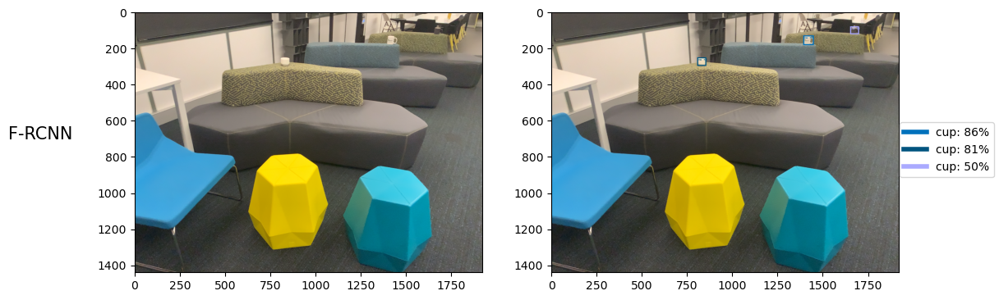

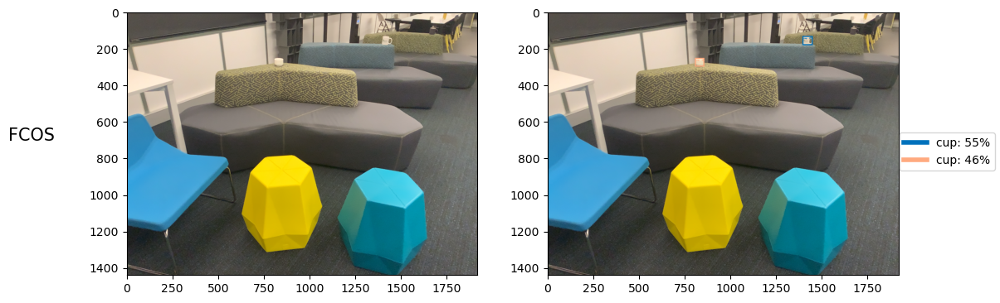

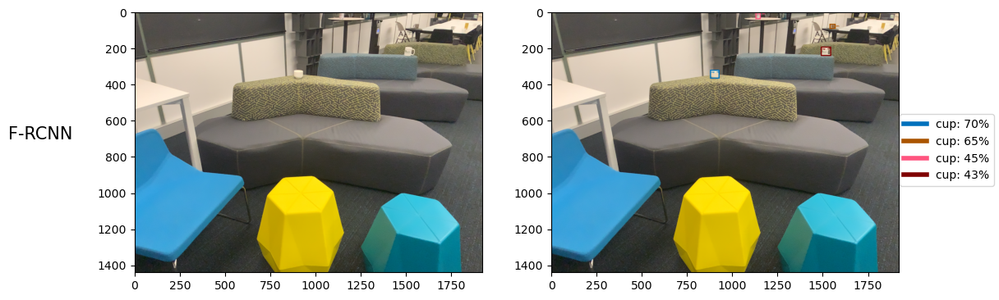

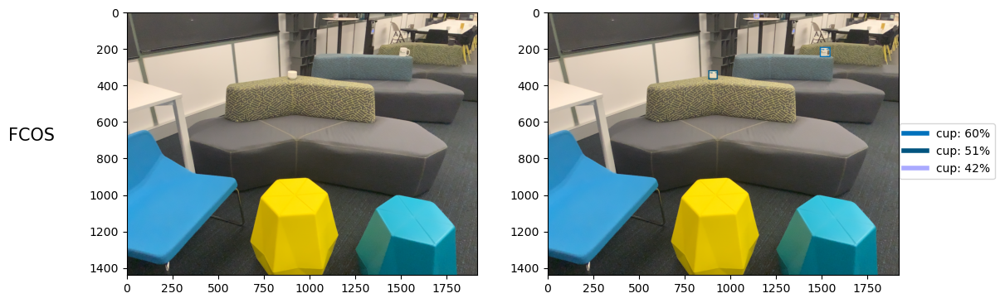

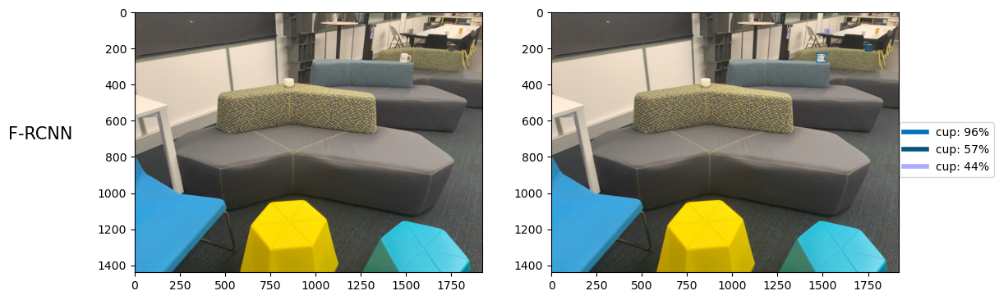

...

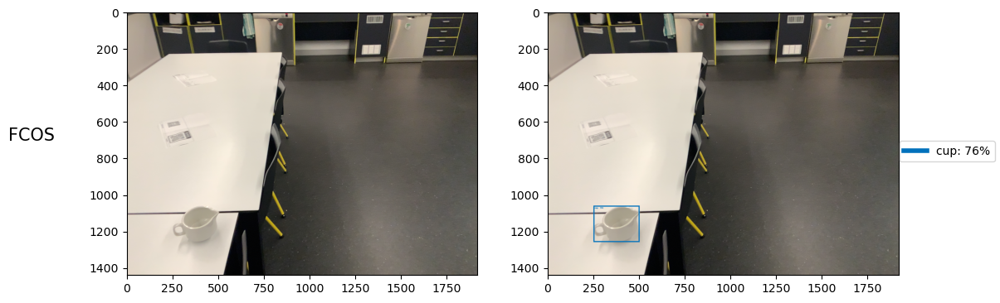

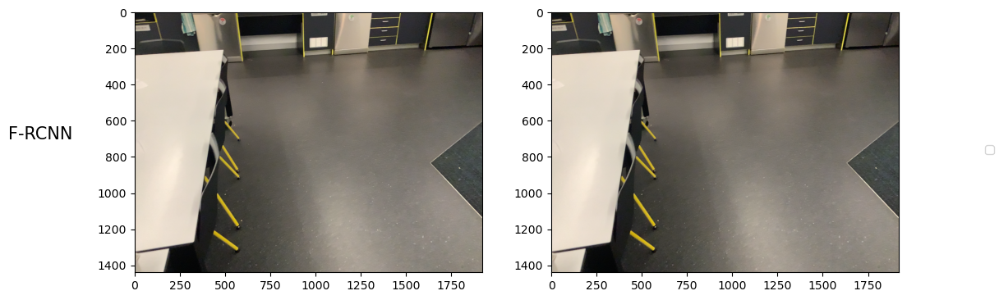

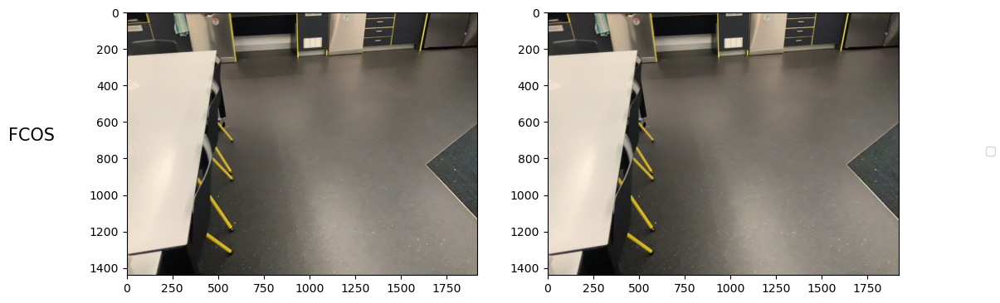

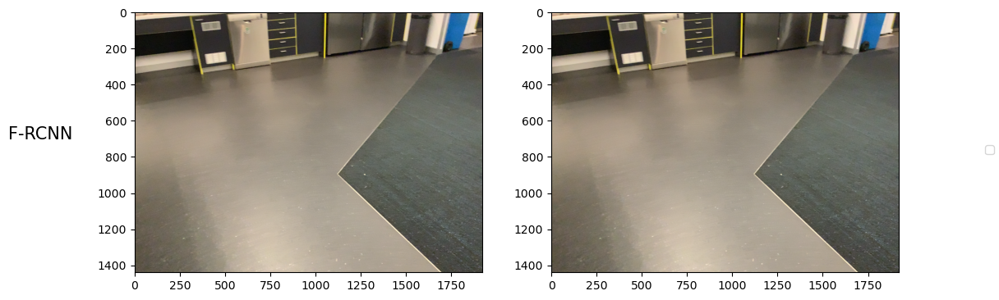

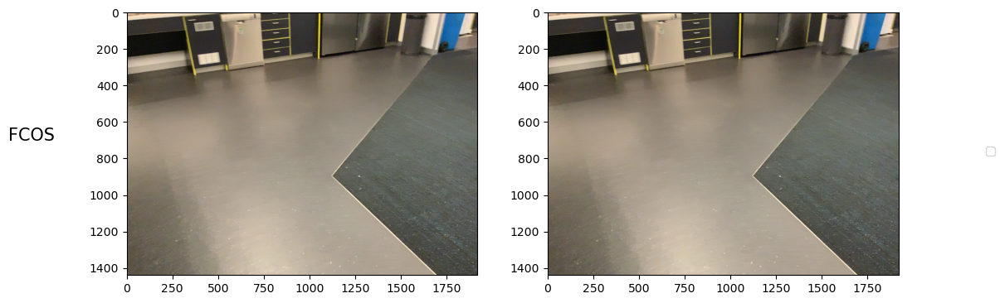

In [ ]:
thresholds = [0.55, 0.4]
for image_file in traj2_img_fn:
    img = read_image(str(image_file))

    for modelName, thresh in zip(models.keys(),thresholds):
        model = models[modelName]

        with torch.no_grad():
            preprocess = weights[modelName].transforms()
            batch = [preprocess(img)]
            prediction = model(batch)[0]

        cup_mask = prediction['labels'] == 47
        prediction['boxes'] = prediction['boxes'][cup_mask]
        prediction['labels'] = prediction['labels'][cup_mask]
        prediction['scores'] = prediction['scores'][cup_mask]
        draw_detections(img, prediction, detectorName=modelName, thresh=thresh)

### Pose Calculation
 find the mug poses by combining the mug-to-camera transform with the estimated world-to-camera pose transform

### Visualise
label the images with the coordinates, print the resulting mug / 3d coord